In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances
import warnings
warnings.filterwarnings("ignore")

In [2]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')

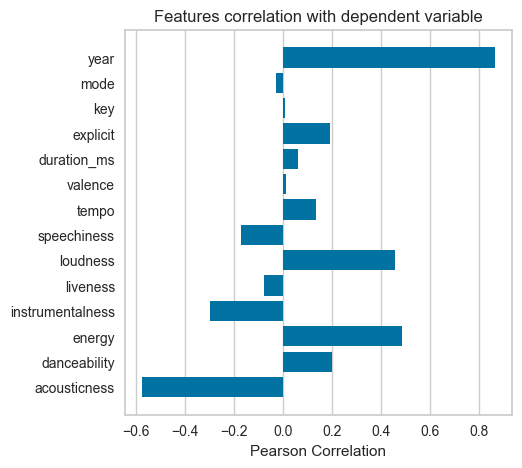

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [3]:

from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'duration_ms', 'explicit', 'key', 'mode', 'year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize'] = (5, 5)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

In [4]:
cluster_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [5]:
tsne_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])

fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.001s...
[t-SNE] Computed neighbors for 2973 samples in 0.144s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106171
[t-SNE] KL divergence after 1000 iterations: 1.392794


In [6]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),('kmeans', KMeans(n_clusters=20, verbose=False))], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [7]:
pca_pipeline = Pipeline([('scaler', StandardScaler()),
                        ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [8]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

clientId = '114445a5b03f4ad9839ee3bb4b2d56ce'
clientSecret = 'e6ae322b1c8c4963bdb2dbb3cad9bf77'
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(
    client_id=clientId, client_secret=clientSecret))


def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q='track: {} year: {}'.format(name, year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [9]:
def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) & (spotify_data['year'] == song['year'])].iloc[0]
        print('Fetching song information from local dataset')
        return song_data

    except IndexError:
        print('Fetching song information from spotify dataset')
        return find_song(song['name'], song['year'])


def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(
                song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    # nd-array where n is number of songs in list. It contains all numerical vals of songs in sep list.
    song_matrix = np.array(list(song_vectors))
    # print(f'song_matrix {song_matrix}')
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []  # 'name', 'year'
    for dic in dict_list:
        for key, value in dic.items():
            flattened_dict[key].append(value)  # creating list of values
    return flattened_dict

In [39]:
def recommend_songs(song_list, spotify_data, dist, n_songs=10):

    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    print(scaled_song_center)
    print(scaled_data[0])
    distances = pairwise_distances(
        scaled_song_center, scaled_data, metric=dist)
    print(distances)
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

# Cosine

In [40]:
recommend_songs([{'name': 'Blinding Lights', 'year': 2019}], data, dist="cosine")

Fetching song information from spotify dataset
[[-0.18842224  1.62871838 -0.89119009  0.43491356 -0.793291    1.19416115
  -0.30395549 -0.53145942  1.36558797 -0.70100542  1.0644206   0.64391197
   0.89653219 -0.40367104 -0.61395459]]
[-1.7828247  -2.15247016  1.27618658 -1.46701268  4.76314621 -1.01398836
 -0.30395549  2.2681019   1.36558797  2.6267188  -1.51423687  0.64391197
 -1.25680847 -0.37970638 -1.16930675]
[[1.49890286 1.21278507 1.61165607 ... 0.3905217  0.80419863 0.44235367]]


[{'name': 'Best News Ever', 'year': 2017, 'artists': "['MercyMe']"},
 {'name': 'Bit By Bit', 'year': 2012, 'artists': "['Mother Mother']"},
 {'name': 'A Different World (feat. Corey Taylor)',
  'year': 2016,
  'artists': "['Korn', 'Corey Taylor']"},
 {'name': 'Sober', 'year': 2015, 'artists': "['Selena Gomez']"},
 {'name': 'Hotel Ceiling', 'year': 2014, 'artists': "['Rixton']"},
 {'name': "Somethin' Bad (with Carrie Underwood) - (Duet with Carrie Underwood)",
  'year': 2014,
  'artists': "['Miranda Lambert', 'Carrie Underwood']"},
 {'name': "Don't Say Goodnight",
  'year': 2014,
  'artists': "['Hot Chelle Rae']"},
 {'name': 'We Go Together Like', 'year': 2020, 'artists': "['Abby Anderson']"},
 {'name': 'Sight of the Sun - Single Version',
  'year': 2014,
  'artists': "['fun.']"},
 {'name': 'I Will Follow', 'year': 2010, 'artists': "['Chris Tomlin']"}]

# Euclidean

In [31]:
recommend_songs([{'name': 'Blinding Lights', 'year': 2019}], data, dist="euclidean")

Fetching song information from spotify dataset


[{'name': 'Best News Ever', 'year': 2017, 'artists': "['MercyMe']"},
 {'name': 'Bit By Bit', 'year': 2012, 'artists': "['Mother Mother']"},
 {'name': 'A Different World (feat. Corey Taylor)',
  'year': 2016,
  'artists': "['Korn', 'Corey Taylor']"},
 {'name': 'Sober', 'year': 2015, 'artists': "['Selena Gomez']"},
 {'name': 'Hotel Ceiling', 'year': 2014, 'artists': "['Rixton']"},
 {'name': "Don't Say Goodnight",
  'year': 2014,
  'artists': "['Hot Chelle Rae']"},
 {'name': 'Sight of the Sun - Single Version',
  'year': 2014,
  'artists': "['fun.']"},
 {'name': 'I Will Follow', 'year': 2010, 'artists': "['Chris Tomlin']"},
 {'name': 'Re-Do', 'year': 2012, 'artists': "['Modern Baseball']"},
 {'name': "Livin' The Dream", 'year': 2016, 'artists': "['Drake White']"}]

# Manhattan

In [32]:
recommend_songs([{'name': 'Blinding Lights', 'year': 2019}], data, dist="manhattan")

Fetching song information from spotify dataset


[{'name': "Don't Say Goodnight",
  'year': 2014,
  'artists': "['Hot Chelle Rae']"},
 {'name': 'A Different World (feat. Corey Taylor)',
  'year': 2016,
  'artists': "['Korn', 'Corey Taylor']"},
 {'name': 'I Will Follow', 'year': 2010, 'artists': "['Chris Tomlin']"},
 {'name': 'Bit By Bit', 'year': 2012, 'artists': "['Mother Mother']"},
 {'name': 'We Go Together Like', 'year': 2020, 'artists': "['Abby Anderson']"},
 {'name': 'Best News Ever', 'year': 2017, 'artists': "['MercyMe']"},
 {'name': 'Sight of the Sun - Single Version',
  'year': 2014,
  'artists': "['fun.']"},
 {'name': 'Ride With Me', 'year': 2011, 'artists': "['Cody Johnson']"},
 {'name': 'Hotel Ceiling', 'year': 2014, 'artists': "['Rixton']"},
 {'name': 'Sober', 'year': 2015, 'artists': "['Selena Gomez']"}]